In [76]:
%load_ext autoreload
%autoreload 2

import sys
import os
import sklearn
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from osgeo import gdal
from matplotlib import patches as mpl_patches
from matplotlib.colors import Colormap
from mpl_toolkits.mplot3d import Axes3D
from sklearn.manifold import TSNE, Isomap, SpectralEmbedding
from sklearn.cluster import SpectralClustering, KMeans, AgglomerativeClustering, AffinityPropagation

sys.path.insert(1, os.path.join(sys.path[0], ".."))
from reproduction.pipeline import load as pipeline
from reproduction.analysis import AEData, plot_cluster_channel_distributions, plot_cluster_samples, plot_all_cluster_samples

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [37]:
model_dir = "../output/mod09cnn13/"

with open(model_dir + "ae.json", "r") as f:
    ae = tf.keras.models.model_from_json(f.read())
ae.load_weights(model_dir + "ae.h5")

In [38]:
data = AEData(
    dataset=pipeline.load_data(
        data_glob="../data/tif/*.tfrecord",
        shape=(128, 128, 7),
        batch_size=32,
        read_threads=4,
        shuffle_buffer_size=100,
        prefetch=2,
        flips=False
    ),
    ae=ae,
    fields=["b%d"%(i+1) for i in range(7)],
    n=3000
)

# Clustering one example swath

In [39]:
swath_tif = gdal.Open("../data/tif/2017-01-31_MOD09GA_background_removal_zero_inputated_image_with_cf_50perc_grid_size10-0000000000-0000052992.tif")


17664 17664


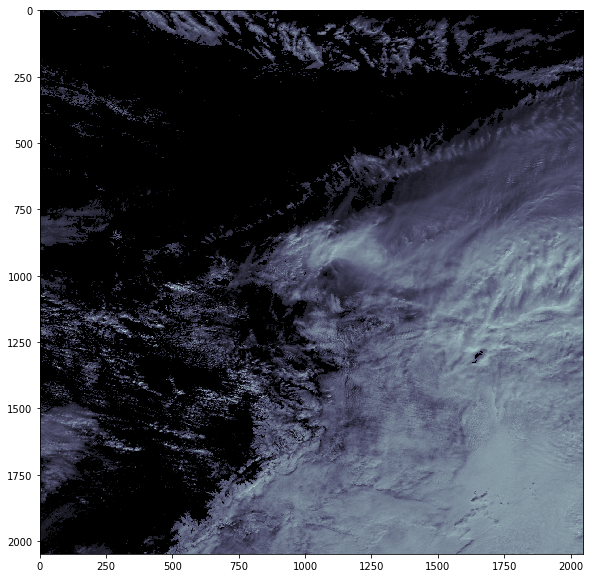

In [40]:
%matplotlib inline
swath = gdal.Open("../data/tif/2017-01-31_MOD09GA_background_removal_zero_inputated_image_with_cf_50perc_grid_size10-0000000000-0000052992.tif")
print(swath.RasterYSize, swath.RasterYSize)

swath = swath.ReadAsArray(xoff=9400, yoff=4600, xsize=2048, ysize=2048)
swath = np.rollaxis(swath, 0, 3)
plt.figure(figsize=(10, 10))
plt.imshow(swath[:,:,0], cmap="bone")

In [41]:
swath_mean = swath.mean(axis=(0,1))
swath_std = swath.std(axis=(0,1))
patches = []

stride = 128
patch_size = 128

patches = []
for i in range(0, swath.shape[0], stride):
    row = []
    for j in range(0, swath.shape[1], stride):
        if i + patch_size < swath.shape[0] and j + patch_size < swath.shape[1]:
            p = swath[i:i + patch_size, j:j + patch_size].astype(float)
            p -= swath_mean
            p /= swath_std
            
            row.append(p)
    if row:
        patches.append(row)
            
patches = np.stack(patches)

In [42]:
_encs, _ = ae.predict(patches.reshape((-1, 128, 128, 7)))
color_map = ["c%d"%i for i in range(10)]

In [ ]:
method = SpectralClustering(6, affinity="rbf")
# method = AffinityPropagation()
features = _encs.mean(axis=(1,2))

In [44]:
patches_labels = method.fit_predict(features).reshape(patches.shape[:2])

In [45]:
# colors = plt.cm.plasma_r(patches_labels / patches_labels.max())
colors = [
    "red",
    "yellow",
    "cyan",
    "magenta",
    "blue",
    "orange",
    "black"
]

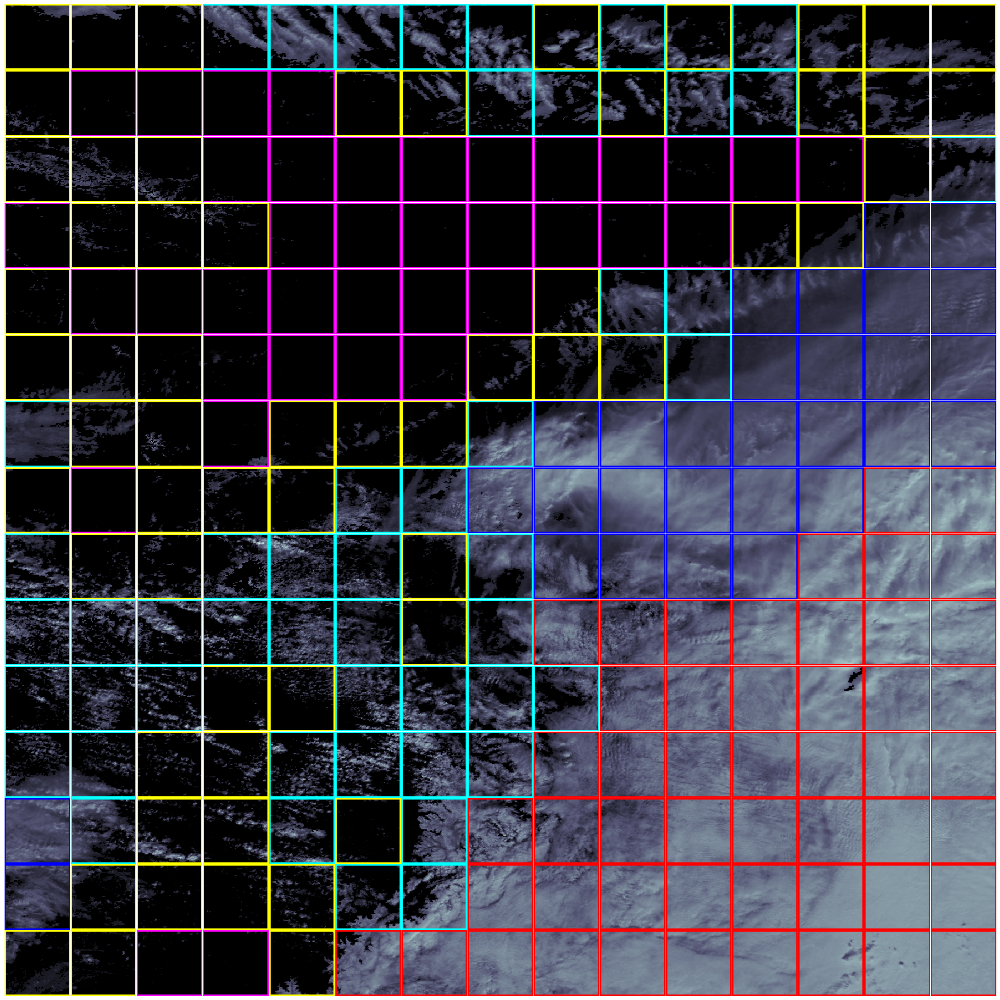

In [46]:
%matplotlib inline

fig, ax = plt.subplots(*patches.shape[:2], figsize=[x*2 for x in patches.shape[:2]])

# Need to use 1 normalization for all patches so its visually consistent with whole swath plot
normalization = plt.Normalize(vmin=patches[:,:,:,:,0].min(), vmax=patches[:,:,:,:,0].max())

for i, row in enumerate(patches):
    for j, patch in enumerate(row):
        a = ax[i,j]
        label = patches_labels[i,j]
        a.imshow(
            patches[i, j, :, :, 0],
            cmap="bone",
            norm=normalization
        )
        plt.setp(a.spines.values(), color=colors[label], linewidth=3)
        a.set_xticks([])
        a.set_yticks([])

plt.tight_layout(pad=-.3) 

# Clustering many random patches

In [47]:
def clusterfy(labels):
    n_clusters = len(set(labels))
    clusters = [set() for _ in range(n_clusters)]
    for i, l in enumerate(labels):
        clusters[l].add(i)
    return clusters

def jaccard_similarity(s1, s2):
    return len(s1 & s2) / len(s1 | s2)

In [48]:
n_clusters = 40
sc = SpectralClustering(n_clusters, affinity="nearest_neighbors").fit(data.pca_project(data, d=100).T)
km = KMeans(n_clusters).fit(data.pca_project(data, d=100).T)

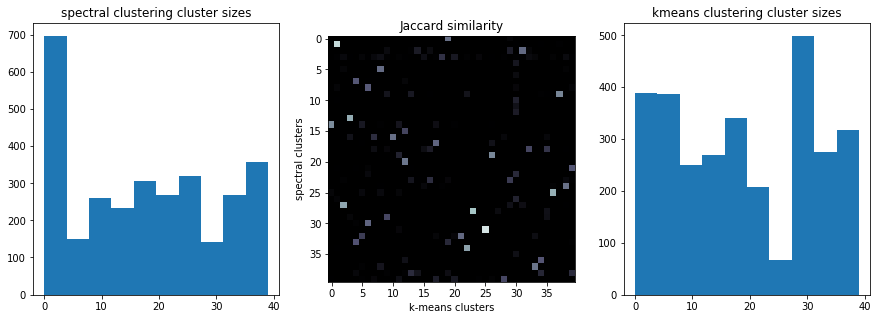

In [49]:
%matplotlib inline
fig, (a, b, c) = plt.subplots(ncols=3, figsize=(15,5))
a.hist(sc.labels_)
a.set_title("spectral clustering cluster sizes")
c.hist(km.labels_);
c.set_title("kmeans clustering cluster sizes")

c1s = clusterfy(sc.labels_)
c2s = clusterfy(km.labels_)
# c1s, c2s = np.random.randint(0, high=70, size=(2, 3000), dtype=np.int32)
# c1s, c2s = clusterfy(c1s), clusterfy(c2s)

jsims = np.zeros((len(c1s), len(c2s)))
for i, c1 in enumerate(c1s):
    for j, c2 in enumerate(c2s):
        jsims[i, j] =  jaccard_similarity(c1, c2)
        
b.set_ylabel("spectral clusters")
b.set_xlabel("k-means clusters")
b.set_title("Jaccard similarity")
b.imshow(jsims, cmap="bone", norm=plt.Normalize(vmin=0, vmax=1));

In [50]:
#fig, ax = plot_cluster_channel_distributions(data.imgs, km.labels_)

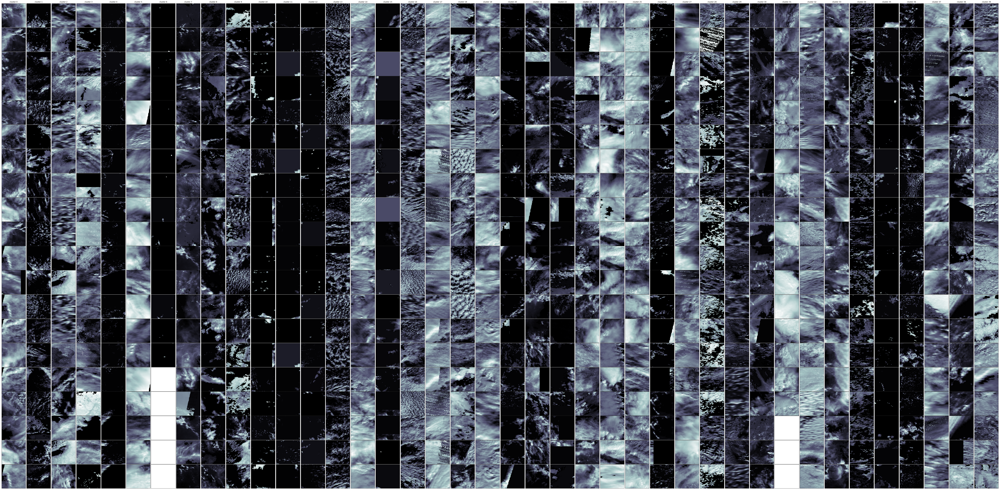

In [51]:
fig, ax = plot_cluster_samples(data.imgs, sc.labels_, samples=20)

In [52]:
#fig, ax = plot_cluster_samples(data.imgs, km.labels_, samples=20)

In [53]:
features = data.pca_project(data, d=100).T
ag = sklearn.cluster.AgglomerativeClustering(
    n_clusters=50,
    connectivity=sklearn.neighbors.kneighbors_graph(features, 20)
).fit_predict(features)

In [54]:
# fig, _ = plot_all_cluster_samples(data.imgs.mean(axis=3), ag)
# fig.savefig("ag_clusters.png")

In [55]:
#fig, ax = plot_cluster_samples(data.imgs, ag, samples=20)

In [56]:
# %matplotlib notebook
# %matplotlib notebook
# %matplotlib notebook

# fig = plt.figure(figsize=(10,10))

# ax = fig.add_subplot(1,1,1, projection="3d")
# ax.scatter(*data.pca_project(data), c=ag)

In [57]:
ap = sklearn.cluster.AffinityPropagation(damping=.5)
ap.fit(data.encs)

AffinityPropagation(affinity='euclidean', convergence_iter=15, copy=True,
          damping=0.5, max_iter=200, preference=None, verbose=False)

In [58]:
np.unique(np.unique(ap.labels_, return_counts=True)[1], return_counts=True)

(array([  2,   5,   9,  11,  13,  14,  19,  20,  21,  22,  24,  26,  27,
         28,  29,  33,  34,  35,  36,  38,  43,  45,  46,  47,  49,  50,
         53,  55,  56,  58,  59,  61,  62,  66,  69,  72,  73,  74,  80,
         83,  91,  97, 101, 109, 191]),
 array([1, 1, 1, 1, 1, 3, 1, 1, 4, 1, 2, 2, 5, 1, 1, 1, 2, 1, 3, 1, 2, 3,
        1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1,
        1]))

In [59]:
# fig, ax = plot_cluster_samples(data.imgs, ap, samples=5)

In [60]:
import scipy as sp

In [61]:
fc = sp.cluster.hierarchy.fclusterdata(data.encs, 0.3, criterion="distance")
uniq, counts = np.unique(fc, return_counts=True)

In [62]:
np.unique(counts, return_counts=True)

(array([   1,    2,    3,    4,    5,    6,    7,   10,   13, 2135]),
 array([662,  49,  17,   2,   2,   1,   1,   1,   1,   1]))

In [63]:
# plot_cluster_samples(data.imgs, fc, samples=10)

In [64]:
# %matplotlib inline
# plt.figure(figsize=(10, 360))
# plt.imshow(data.imgs[ap.labels_ == 0].reshape((-1, 128, 7)).mean(axis=2))
# plt.savefig("foo.png")

<IPython.core.display.Javascript object>


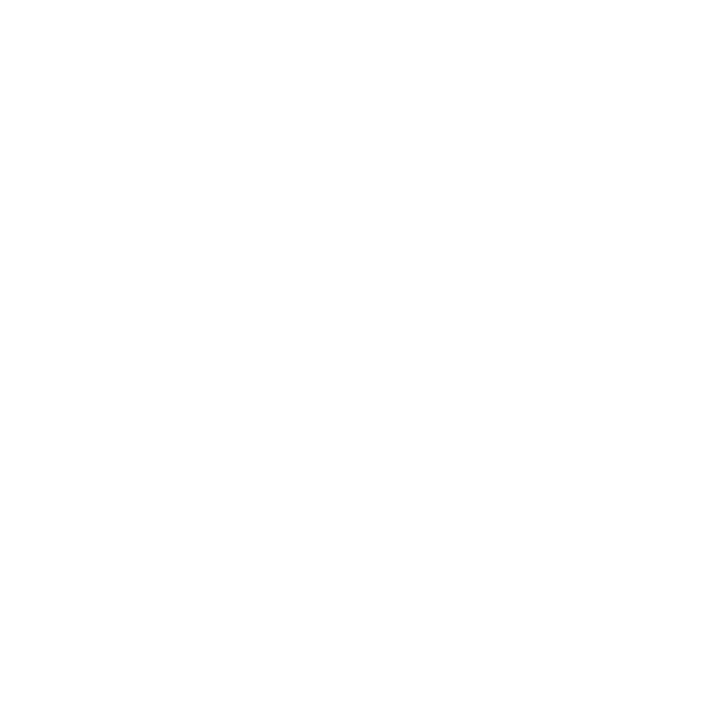

In [65]:
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook
%matplotlib notebook

fig = plt.figure(figsize=(10,10))

ax = fig.add_subplot(1,1,1, projection="3d")
ax.scatter(*data.pca_project(data), c=sc.labels_);

In [66]:
sc.labels_.shape

(3000,)

In [67]:
data.names[0]

'/Users/casperneo/work/cloud-research/clouds/data/tif/2017-01-10_MOD09GA_background_removal_zero_inputated_image_with_cf_50perc_grid_size10-0000000000-0000035328.tif'

In [68]:
g = b'/Users/casperneo/work/cloud-research/clouds/data/tif/2017-01-08_MOD09GA_background_removal_zero_inputated_image_with_cf_50perc_grid_size10-0000000000-0000070656.tif'

In [69]:
n = np.array([g[2:-1] for g in data.names])

In [70]:
n[0]

'sers/casperneo/work/cloud-research/clouds/data/tif/2017-01-10_MOD09GA_background_removal_zero_inputated_image_with_cf_50perc_grid_size10-0000000000-0000035328.ti'

In [71]:
type(data.coords.astype(np.int32)[0,0])

numpy.int32

In [72]:
swath = gdal.Open(data.names[4])

In [73]:
swath.RasterXSize

17664

In [74]:
def open_neighborhood(data, i, context_width=128):
    yoff, xoff = data.coords[i]
    xsize, ysize = data.imgs.shape[1:3]
    
    def rebox(off, size, mx):
        l_most = max(off - context_width, 0)
        r_most = min(mx, off + size + context_width)
        new_size = r_most - l_most
        return map(int, [l_most, new_size, off - l_most])
        
    swath = gdal.Open(data.names[i])
    xoff, xsize, left = rebox(xoff, xsize, swath.RasterXSize)
    yoff, ysize, top = rebox(yoff, ysize, swath.RasterYSize)
    
    p = swath.ReadAsArray(xoff, yoff, xsize, ysize)
    
    return p, (left, top)


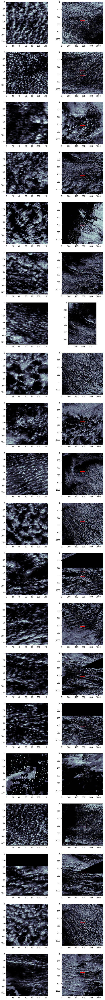

In [84]:
%matplotlib inline

nsamples = 20
width=5

fig, ax = plt.subplots(nsamples, 2, figsize=(2 * width, nsamples * width))

for row, i in enumerate(np.where(sc.labels_ == 13)[0][:nsamples]):
    channel = 0
    context_width = 500

    p, orig = open_neighborhood(data, i, context_width)
    
    a, b = ax[row]
    a.imshow(data.imgs[i,:,:, channel], cmap="bone")
    b.imshow(p[channel], cmap="bone") 
    b.add_patch(
        mpl_patches.Rectangle(
            orig,
            *data.imgs.shape[1:3],
            linewidth=1,
            edgecolor='r',
            facecolor='none'
        )
    )

In [ ]:
np.where(sc.labels_ == 7)